In [1]:
# the code for this section is from https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html

In [2]:
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
from torch.utils.data import DataLoader, random_split
import torchvision.transforms as transforms
from torchvision import datasets
import torchvision.transforms as transforms


# Set random seed for reproducibility
manualSeed = 999
# manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)
torch.use_deterministic_algorithms(True) # Needed for reproducible results

Random Seed:  999


In [3]:
import torch
torch.cuda.empty_cache()

In [4]:

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 128

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 350

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparameter for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

In [5]:
transform = transforms.Compose([
    transforms.Resize(image_size),
    transforms.CenterCrop(image_size),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
    
])
print(transform)

Compose(
    Resize(size=64, interpolation=bilinear, max_size=None, antialias=True)
    CenterCrop(size=(64, 64))
    ToTensor()
    Normalize(mean=(0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5))
)


In [6]:

train_dataset = datasets.CIFAR10(root='./data', train=True, download=True, transform=transform)
val_dataset = datasets.CIFAR10(root='./data', train=False, download=True, transform=transform)

# Function to split the dataset
train_loader = DataLoader(dataset=train_dataset, batch_size=32, shuffle=True)
val_loader = DataLoader(dataset=val_dataset, batch_size=32, shuffle=False)



# print the size of the datasets
print(f"Train size: {len(train_loader.dataset)}")
print(f"Validation size: {len(val_loader.dataset)}")
# print the shape of images after transformation
for images, labels in train_loader:
    print(f"Shape of batch of images after transformation: {images.shape}")
    break


Files already downloaded and verified
Files already downloaded and verified
Train size: 50000
Validation size: 10000
Shape of batch of images after transformation: torch.Size([32, 3, 64, 64])


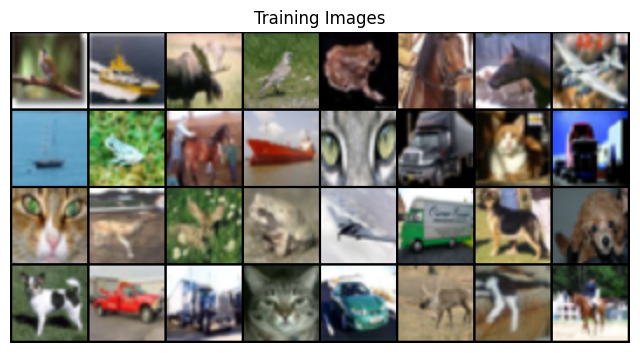

In [7]:
# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(train_loader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()


In [8]:
# custom weights initialization called on ``netG`` and ``netD``
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [9]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. ``(ngf*8) x 4 x 4``
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. ``(ngf*4) x 8 x 8``
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. ``(ngf*2) x 16 x 16``
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. ``(ngf) x 32 x 32``
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. ``(nc) x 64 x 64``
        )

    def forward(self, input):
        return self.main(input)

In [10]:
# Create the generator
netG = Generator(ngpu).to(device)


# Apply the ``weights_init`` function to randomly initialize all weights to ``mean=0``, ``stdev=0.02``.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [11]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is ``(nc) x 64 x 64``
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf) x 32 x 32``
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*2) x 16 x 16``
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*4) x 8 x 8``
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*8) x 4 x 4``
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [12]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)


# Apply the ``weights_init`` function to randomly initialize all weights
# like this: ``to mean=0, stdev=0.2``.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [13]:
# Initialize the ``BCELoss`` function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [14]:
from skimage.metrics import structural_similarity as ssim
import torch.nn.functional as F
import cv2
# compute the mean squared error and the ssim score
def compute_mse(x, recon_x):
    x = F.relu(x)
    mse_loss = F.mse_loss(x, recon_x, reduction='sum')
    return mse_loss




def compute_ssim(x, recon_x):
    # Permute to (batch, height, width, channels) for SSIM
    x = x.permute(0, 2, 3, 1).detach().cpu().numpy()
    recon_x = recon_x.permute(0, 2, 3, 1).detach().cpu().numpy()
    
    # Calculate SSIM without converting to grayscale again
    ssim_scores = []
    for i in range(x.shape[0]):
        # print the shape of the images
        
        score = ssim(x[i], recon_x[i],win_size=11, channel_axis=-1,data_range=1)
        ssim_scores.append(score)
    
    # Print average SSIM score for the batch
    avg_ssim = sum(ssim_scores) / len(ssim_scores)
    
    return 1 - avg_ssim  # Return SSIM loss



In [15]:
# Imports for plotting and SSIM computation
import matplotlib.pyplot as plt
from skimage.metrics import structural_similarity as ssim

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
MSE_losses = []
SSIM_losses = []
test_MSE_losses = []
test_SSIM_losses = []
iters = 0
mse_train = 0.0
ssim_train = 0.0
G_losse = 0
D_losse = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(train_loader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        output = netD(real_cpu).view(-1)
        errD_real = criterion(output, label)
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        fake = netG(noise)
        label.fill_(fake_label)
        output = netD(fake.detach()).view(-1)
        errD_fake = criterion(output, label)
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        errD = errD_real + errD_fake
        optimizerD.step()
        D_losse += errD.item()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)
        output = netD(fake).view(-1)
        errG = criterion(output, label)
        errG.backward()
        G_losse += errG.item()

        D_G_z2 = output.mean().item()
        optimizerG.step()

        # Calculate MSE and SSIM for the training set
        mse = compute_mse(real_cpu, fake)
        SSIM_losse = compute_ssim(real_cpu, fake)
        mse_train += mse.item()
        ssim_train += SSIM_losse.item()
        # Output training stats
        if i % 1563 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tMSE LOSS: %.4f\tSSIM LOSS: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(train_loader),
                     errD.item(), errG.item(), mse.item(), SSIM_losse.item(), D_x, D_G_z1, D_G_z2))


        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(train_loader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1
        # Save Losses for plotting later
    G_losses.append(G_losse / len(train_loader))
    D_losses.append(D_losse / len(train_loader))
    MSE_losses.append(mse_train / len(train_loader))
    SSIM_losses.append(ssim_train / len(train_loader))

    # Validation phase: Calculate MSE and SSIM on the test set
    test_mse = 0.0
    test_ssim = 0.0
    num_batches = 0
    with torch.no_grad():
        for i, data in enumerate(val_loader, 0):
            real_cpu = data[0].to(device)
            b_size = real_cpu.size(0)
            noise = torch.randn(b_size, nz, 1, 1, device=device)
            fake = netG(noise)

            # Compute MSE
            mse = compute_mse(real_cpu, fake)
            test_mse += mse.item()

            # Compute SSIM
            # Converting tensors to numpy for SSIM computation
            real_cpu_np = real_cpu.cpu().numpy()
            fake_np = fake.cpu().numpy()
            batch_ssim = compute_ssim(real_cpu, fake)
            test_ssim += batch_ssim

            num_batches += 1

    # Average over batches
    test_mse /= num_batches
    test_ssim /= num_batches

    print(f"Validation Epoch [{epoch+1}/{num_epochs}] - Test MSE: {test_mse:.4f}, Test SSIM: {test_ssim:.4f}")
    test_MSE_losses.append(test_mse)
    test_SSIM_losses.append(test_ssim)



Starting Training Loop...
[0/350][0/1563]	Loss_D: 1.9828	Loss_G: 6.3717	MSE LOSS: 68376.6953	SSIM LOSS: 1.0002	D(x): 0.5330	D(G(z)): 0.6609 / 0.0025
Validation Epoch [1/350] - Test MSE: 170975.9469, Test SSIM: 0.9923
[1/350][0/1563]	Loss_D: 0.6356	Loss_G: 3.1726	MSE LOSS: 197132.5469	SSIM LOSS: 0.9895	D(x): 0.7313	D(G(z)): 0.1545 / 0.0619
Validation Epoch [2/350] - Test MSE: 154550.3642, Test SSIM: 0.9927
[2/350][0/1563]	Loss_D: 0.4147	Loss_G: 4.1079	MSE LOSS: 130414.5703	SSIM LOSS: 0.9920	D(x): 0.7950	D(G(z)): 0.1434 / 0.0316
Validation Epoch [3/350] - Test MSE: 114198.0781, Test SSIM: 0.9916
[3/350][0/1563]	Loss_D: 0.0869	Loss_G: 4.7885	MSE LOSS: 116868.1250	SSIM LOSS: 0.9987	D(x): 0.9928	D(G(z)): 0.0742 / 0.0116
Validation Epoch [4/350] - Test MSE: 100926.8602, Test SSIM: 0.9917
[4/350][0/1563]	Loss_D: 0.0419	Loss_G: 5.3338	MSE LOSS: 96742.7891	SSIM LOSS: 0.9954	D(x): 0.9739	D(G(z)): 0.0148 / 0.0072
Validation Epoch [5/350] - Test MSE: 102873.2520, Test SSIM: 0.9922
[5/350][0/1563]	

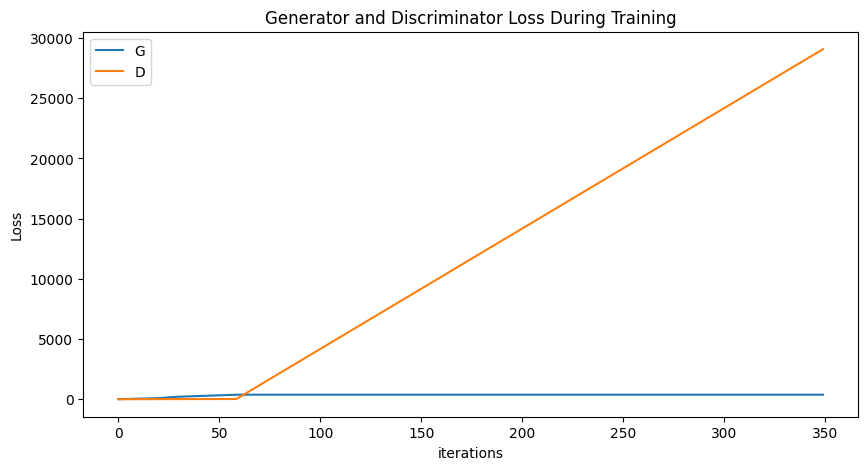

In [16]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()


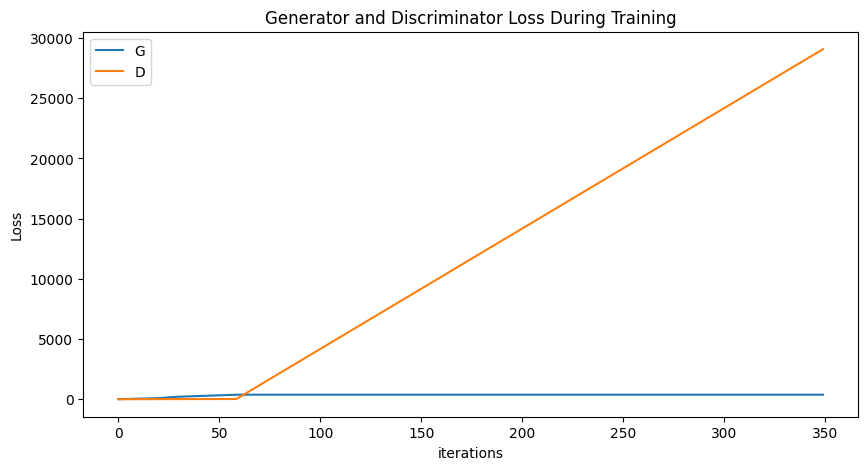

In [17]:
# Plotting results
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses, label="G")
plt.plot(D_losses, label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()




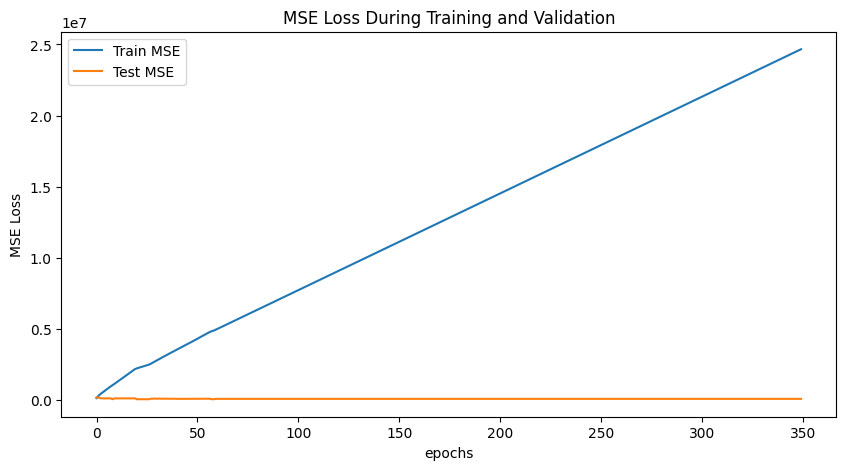

In [18]:
plt.figure(figsize=(10,5))
plt.title("MSE Loss During Training and Validation")
plt.plot(MSE_losses, label="Train MSE")
plt.plot(test_MSE_losses, label="Test MSE")
plt.xlabel("epochs")
plt.ylabel("MSE Loss")
plt.legend()
plt.show()


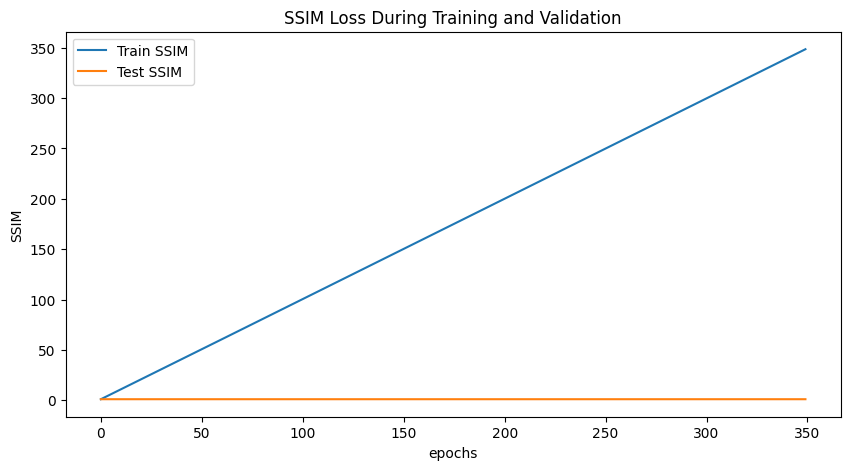

In [19]:
plt.figure(figsize=(10,5))
plt.title("SSIM Loss During Training and Validation")
plt.plot(SSIM_losses, label="Train SSIM")
plt.plot(test_SSIM_losses, label="Test SSIM")
plt.xlabel("epochs")
plt.ylabel("SSIM")
plt.legend()
plt.show()


Animation size has reached 21464615 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


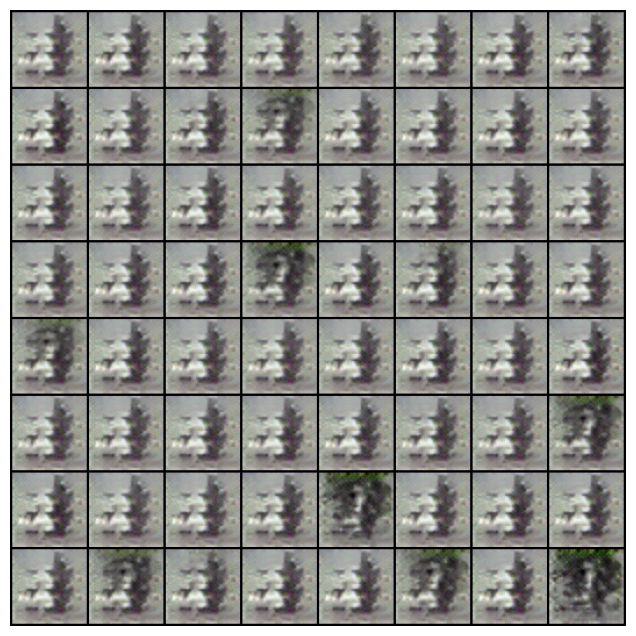

In [20]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())


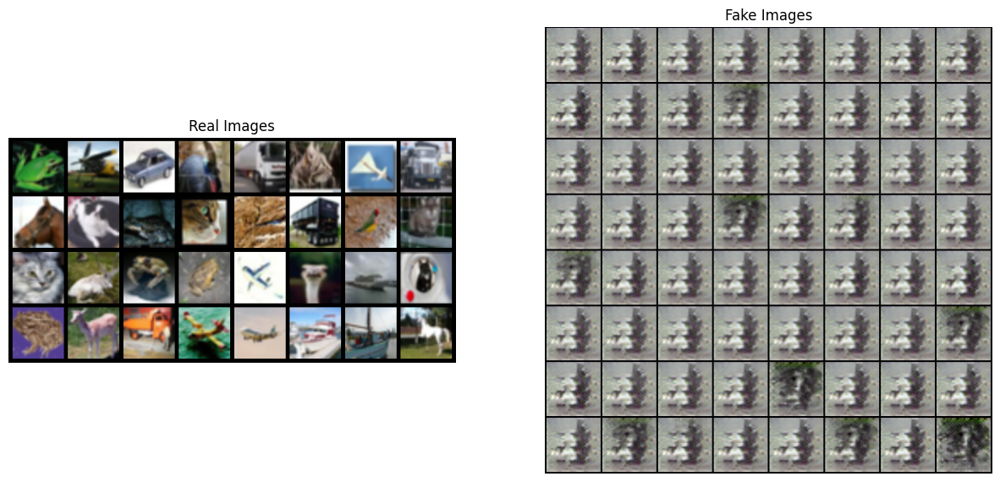

In [21]:
real_batch = next(iter(train_loader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()


In [ ]:
real_batch = next(iter(train_loader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()
